## Lab 11

### Zad 1

In [1]:
using Plots, FFTW

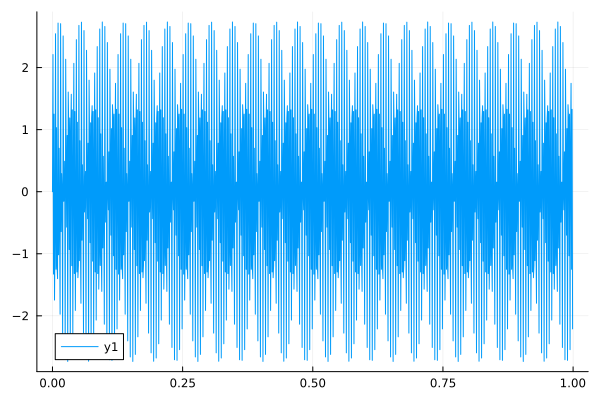

In [2]:
Fs = 1024
t = 0:1/Fs:1-1/Fs
x = sin.(2*pi*t*200) + 2* sin.(2*pi*t*400) # sygnał
plot(t,x)

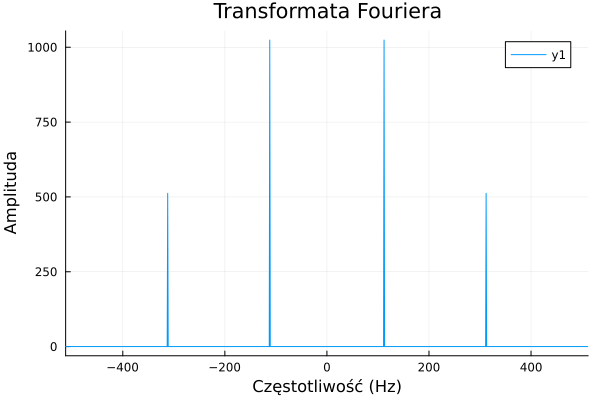

In [3]:
y = fft(x)
n = length(y)
freqs = (0:n-1) * (Fs / n)

# Przesunięcie częstotliwości do zakresu od -Fs/2 do Fs/2
y_shifted = fftshift(y)
freqs_shifted = fftshift(freqs .- Fs/2)

plot(freqs_shifted, abs.(y_shifted), xlabel="Częstotliwość (Hz)", ylabel="Amplituda", title="Transformata Fouriera", xlim=(-Fs/2, Fs/2))


### Zad 2

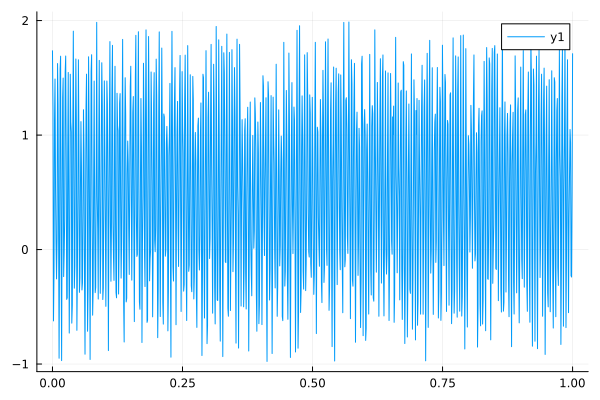

In [4]:
Fs = 1024
t = 0:1/(Fs-1):1
x = cos.(2*pi*t*200) .+ rand(length(t))
plot(t, x)

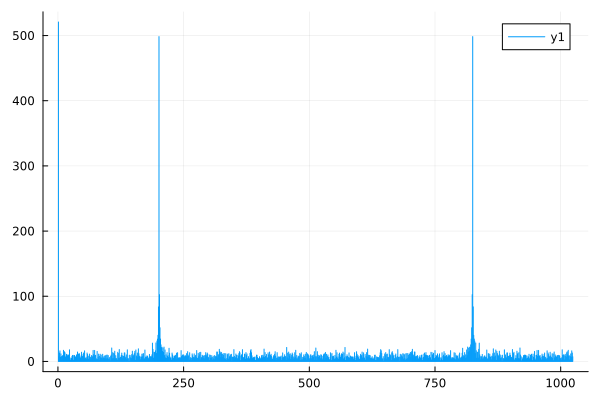

In [5]:
y = fft(x)
sticks((abs.(y)))

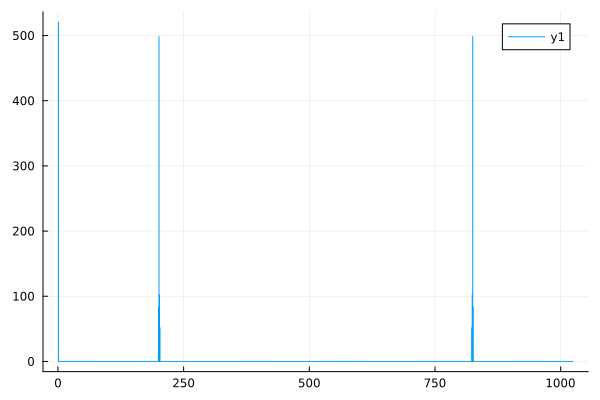

In [6]:
for i in 1:length(y)
    if abs(y[i]) <= 50
        y[i] = 0
    end
end

sticks((abs.(y)))

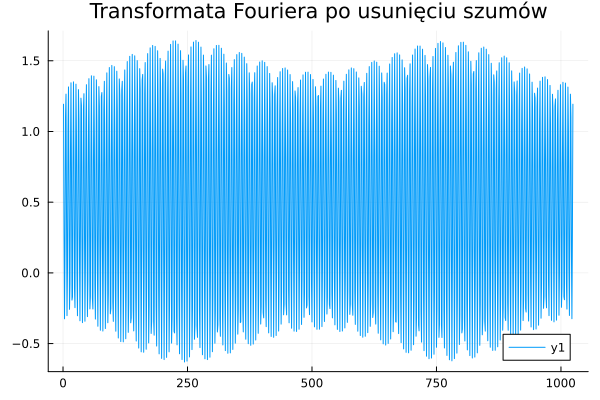

In [7]:
plot(real(ifft(y)), title="Transformata Fouriera po usunięciu szumów")

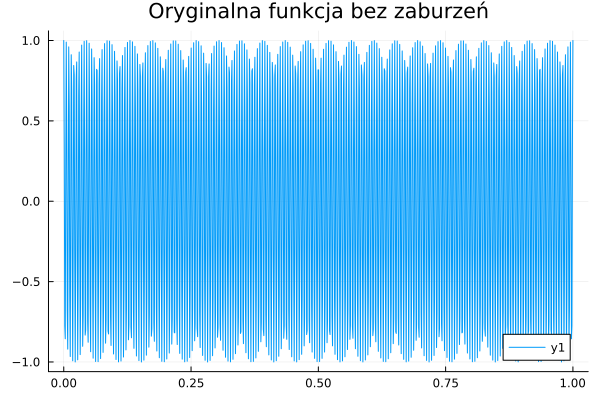

In [8]:
x1 = cos.(2*pi*t*200)
plot(t, x1, title="Oryginalna funkcja bez zaburzeń")

### Zad 3

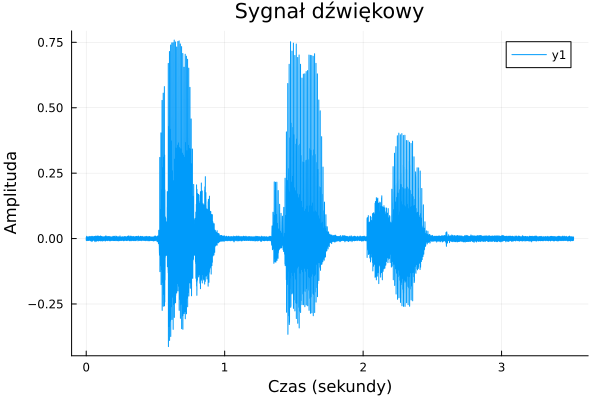

In [9]:
using WAV, FFTW

function add_white_noise(signal, amplitude)
    noise = randn(length(signal)) * amplitude/2
    return signal + noise
end

filename = "glos.wav"
signal, fs = wavread(filename)

# Sprawdź liczbę kanałów
if ndims(signal) == 1
    # Sygnał mono
    time = (0:length(signal)-1) / fs
else
    # Sygnał stereo - wybierz pierwszy kanał lub przekształć na mono
    signal = signal[:, 1]  
    time = (0:size(signal, 1)-1) / fs
end

amplitude = 0.005
signal = add_white_noise(signal, amplitude)

plot(time, signal, title="Sygnał dźwiękowy", xlabel="Czas (sekundy)", ylabel="Amplituda")

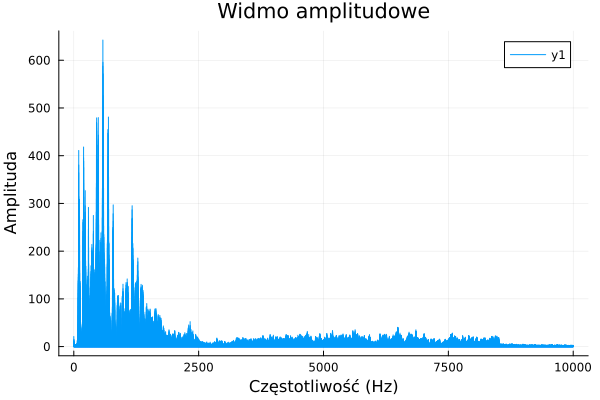

In [10]:
fft_signal = fft(signal)
n = length(fft_signal)
frequencies = (0:n-1) * (fs / n)

# Define the frequency range for plotting
f_min = 0
f_max = 10000

# Select the range of interest
indices = (frequencies .>= f_min) .& (frequencies .<= f_max)
plot_frequencies = frequencies[indices]
plot_fft_signal = abs.(fft_signal)[indices]

sticks(plot_frequencies, plot_fft_signal, title="Widmo amplitudowe", xlabel="Częstotliwość (Hz)", ylabel="Amplituda")


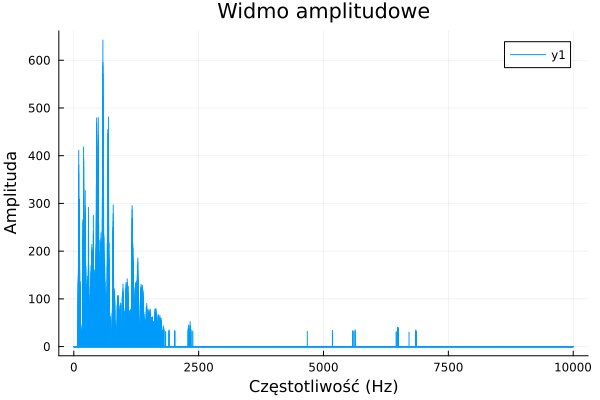

In [11]:
for i in 1:length(fft_signal)
    if abs(fft_signal[i]) <= 30
        fft_signal[i] = 0
    end
end

# sticks((abs.(fft_signal)))
indices = (frequencies .>= f_min) .& (frequencies .<= f_max)
plot_frequencies = frequencies[indices]
plot_fft_signal = abs.(fft_signal)[indices]

sticks(plot_frequencies, plot_fft_signal, title="Widmo amplitudowe", xlabel="Częstotliwość (Hz)", ylabel="Amplituda")

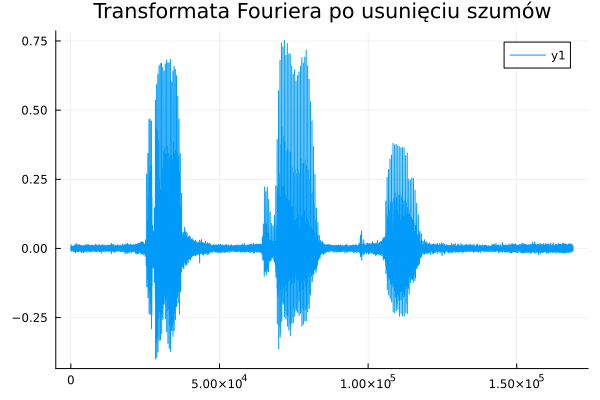

In [12]:
filtered_segment = real(ifft(fft_signal))

plot(filtered_segment, title="Transformata Fouriera po usunięciu szumów")

In [13]:
reconstructed_signal = ifft(fft_signal)

# Rozdziel część rzeczywistą i urojoną
real_part = real(reconstructed_signal)
imag_part = imag(reconstructed_signal)

# Połącz je w sygnał dwukanałowy
combined_signal = hcat(real_part, imag_part)

output_filename = "wynik.wav"
wavwrite(combined_signal, fs, output_filename)